<a href="https://colab.research.google.com/github/Alriyan1/yolov8_tutorial/blob/main/counter.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install ultralytics
import torch
from ultralytics import YOLO
from IPython.display import display, Image

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.9/41.9 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 871.6/871.6 kB 22.9 MB/s eta 0:00:00


In [2]:
torch.__version__

'2.4.0+cu121'

In [3]:
torch.cuda.get_device_name(0)

'Tesla T4'

In [4]:
import time
import cv2
import numpy as np
import torch.backends.cudnn as cudnn
import colorsys

In [5]:
model = YOLO("yolov8n.pt")
results = model('https://www.inclusivecitymaker.com/wp-content/uploads/2021/09/communication-blind-people.jpg',save=True)

100%|██████████| 6.25M/6.25M [00:00<00:00, 109MB/s]


100%|██████████| 349k/349k [00:00<00:00, 451kB/s]


image 1/1 /content/communication-blind-people.jpg: 448x640 2 persons, 3 chairs, 67.8ms
Speed: 13.7ms preprocess, 67.8ms inference, 1212.7ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict


In [6]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

import detectron2
print("detectron2:", detectron2.__version__)

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-3tmyui4t
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-3tmyui4t
  Resolved https://github.com/facebookresearch/detectron2.git to commit ebe8b45437f86395352ab13402ba45b75b4d1ddb
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 4.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.2/78.2 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 10.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 14.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 57.0 MB/s eta 0:00:00
  Created wheel for detectron2: filename=detectron2-0.6-cp3

In [7]:
!pip install supervision
import supervision as sv

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 151.5/151.5 kB 5.6 MB/s eta 0:00:00


In [8]:
from supervision.assets import download_assets, VideoAssets
from IPython import display


download_assets(VideoAssets.MARKET_SQUARE)
download_assets(VideoAssets.GROCERY_STORE)
download_assets(VideoAssets.SUBWAY)


display.clear_output()



0: 736x1280 1 person, 2 bottles, 1 chair, 1 refrigerator, 41.7ms
Speed: 13.4ms preprocess, 41.7ms inference, 1.5ms postprocess per image at shape (1, 3, 736, 1280)


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


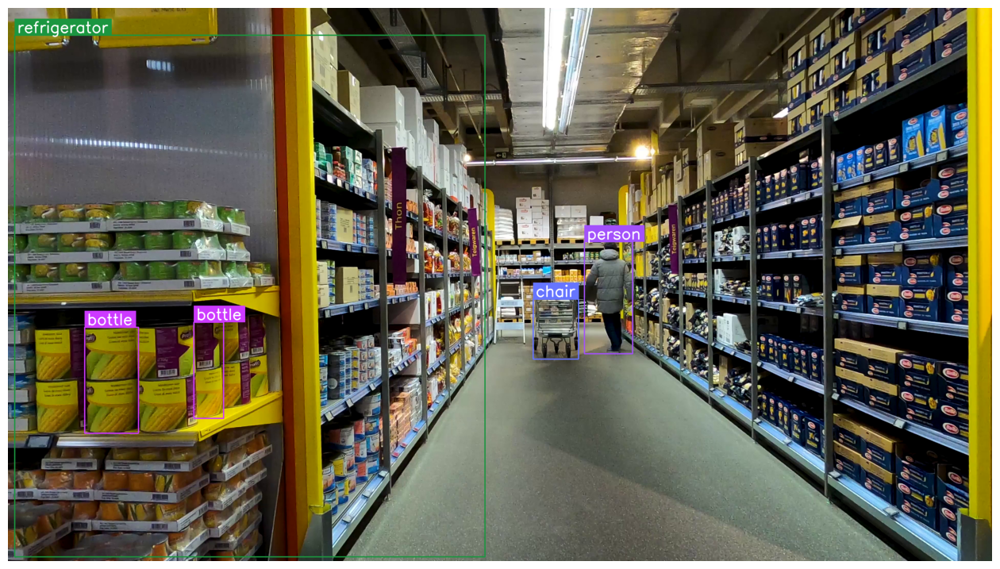

In [9]:
# extract the vidoe frame
generator = sv.get_video_frames_generator(VideoAssets.GROCERY_STORE.value)
iterator = iter(generator)
frame = next(iterator)

# detect
results = model(frame,imgsz=1280)[0]
detection = sv.Detections.from_ultralytics(results)

# annotate
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4,text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detection)
frame = label_annotator.annotate(scene=frame, detections=detection)

# display
%matplotlib inline
sv.plot_image(frame, size=(16,16))


0: 736x1280 1 person, 2 bottles, 1 chair, 1 refrigerator, 13.4ms
Speed: 8.8ms preprocess, 13.4ms inference, 1.8ms postprocess per image at shape (1, 3, 736, 1280)


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


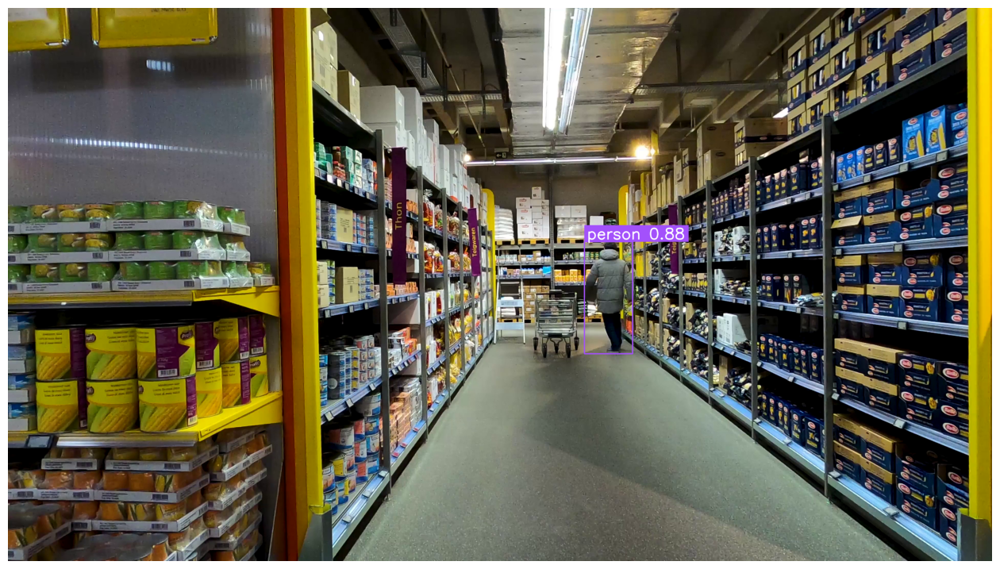

In [10]:
from ast import increment_lineno
# for detection of person

# extract video frame
generator = sv.get_video_frames_generator(VideoAssets.GROCERY_STORE.value)
iterator = iter(generator)
frame = next(iterator)

# detect
results = model(frame, imgsz=1280)[0]
detection = sv.Detections.from_ultralytics(results)
detection = detection[detection.class_id == 0]

# annotate
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4,text_scale=2)
labels = [f"{model.names[class_id]} {confidence:0.2f}" for _,_, confidence, class_id,_,_ in detection]
frame = box_annotator.annotate(scene=frame, detections=detection)
frame = label_annotator.annotate(scene=frame, detections=detection, labels=labels)

%matplotlib inline
sv.plot_image(frame, (16,16))

Now we can add a polgon zone to the scene and visualize it

In [11]:
sv.VideoInfo.from_video_path(VideoAssets.GROCERY_STORE.value)

VideoInfo(width=3840, height=2160, fps=29, total_frames=1002)

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.



0: 736x1280 1 person, 2 bottles, 1 chair, 1 refrigerator, 20.0ms
Speed: 11.5ms preprocess, 20.0ms inference, 2.3ms postprocess per image at shape (1, 3, 736, 1280)


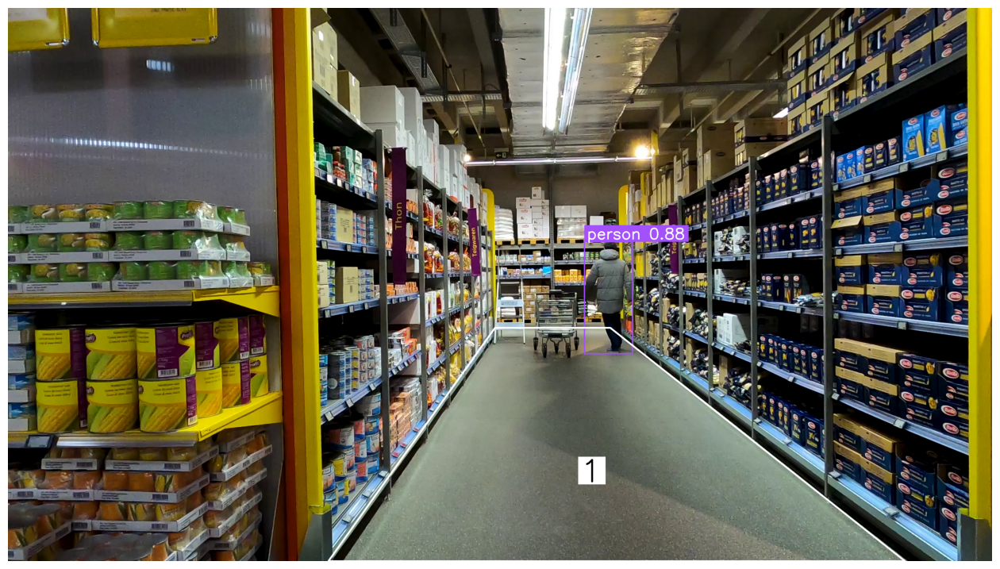

In [12]:
# initiate polgon
polygon = np.array([
    [1900,1250],
    [2350,1250],
    [3500,2160],
    [1250,2160]
])
video_info = sv.VideoInfo.from_video_path(VideoAssets.GROCERY_STORE.value)
zone = sv.PolygonZone(polygon=polygon)

# initiate annotator
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4,text_scale=2)
zone_annotator = sv.PolygonZoneAnnotator(zone=zone, color=sv.Color.WHITE, thickness=6,text_thickness=6,text_scale=4)

# extract video frame
generator = sv.get_video_frames_generator(VideoAssets.GROCERY_STORE.value)
iterator = iter(generator)
frame = next(iterator)

# detect
results = model(frame,imgsz=1280)[0]
detection = sv.Detections.from_ultralytics(results)
detection = detection [detection.class_id == 0]
zone.trigger(detections=detection)

# annotate
labels= [f"{model.names[class_id]} {confidence:0.2f}" for _,_,confidence,class_id,_,_ in detection]
frame = box_annotator.annotate(scene=frame, detections=detection)
frame = label_annotator.annotate(scene=frame, detections=detection, labels=labels)
frame = zone_annotator.annotate(scene=frame)

%matplotlib inline
sv.plot_image(frame, (16,16))

number visible in the middle of the zone we painted. Now lets try to change its location and save what happen

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.



0: 736x1280 1 person, 2 bottles, 1 chair, 1 refrigerator, 25.9ms
Speed: 16.4ms preprocess, 25.9ms inference, 7.0ms postprocess per image at shape (1, 3, 736, 1280)


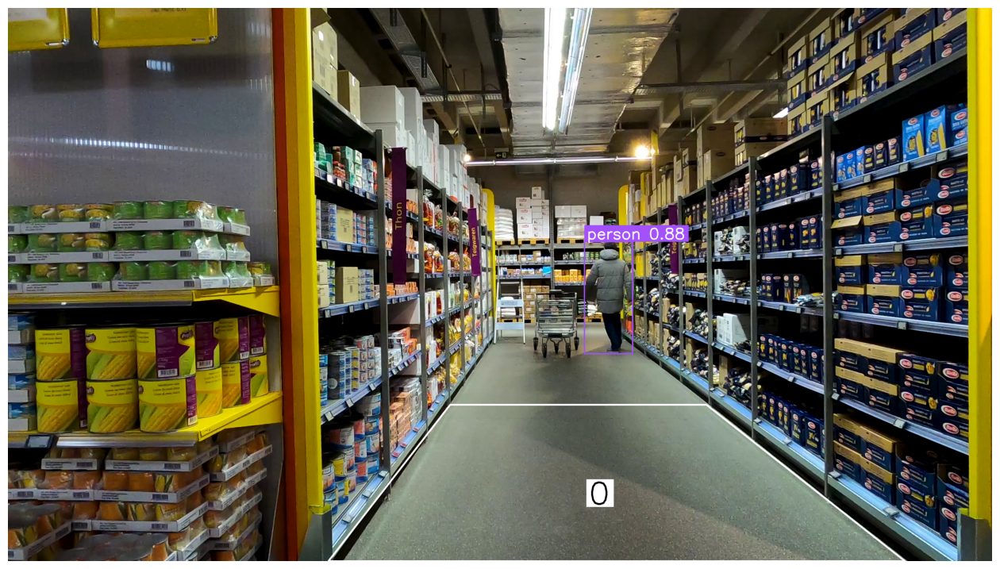

In [13]:
# initiate polygon zone
polygon = np.array([
    [1725,1550],
    [2725,1550],
    [3500,2160],
    [1250,2160]
])

video_info = sv.VideoInfo.from_video_path(VideoAssets.GROCERY_STORE.value)
zone = sv.PolygonZone(polygon=polygon)

# initiate annotators
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4,text_scale=2)
zone_annotator = sv.PolygonZoneAnnotator(zone=zone, color=sv.Color.WHITE, thickness=6, text_thickness=6, text_scale=4)

# extract video frame
generator = sv.get_video_frames_generator(VideoAssets.GROCERY_STORE.value)
iterator = iter(generator)
frame = next(iterator)

# detect
results = model(frame,imgsz=1280)[0]
detection = sv.Detections.from_ultralytics(results)
detection = detection[detection.class_id == 0]
zone.trigger(detections=detection)

# annotate
labels = [f"{model.names[class_id]} {confidence:0.2f}" for _,_,confidence,class_id,_,_ in detection]
frame = box_annotator.annotate(scene=frame, detections=detection)
frame = label_annotator.annotate(scene=frame, detections=detection, labels=labels)
frame = zone_annotator.annotate(scene=frame)

%matplotlib inline
sv.plot_image(frame, (16,16))

try on whole video

In [14]:
# initiate polygon zone
polygon = np.array([
    [1725,1550],
    [2725,1550],
    [3500,2160],
    [1250,2160]
])
video_info = sv.VideoInfo.from_video_path(VideoAssets.GROCERY_STORE.value)
zone = sv.PolygonZone(polygon=polygon)

# initiate annotators
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4,text_scale=2)
zone_annotator = sv.PolygonZoneAnnotator(zone=zone, color=sv.Color.WHITE, thickness=6, text_thickness=6, text_scale=4)

def process_frame(frame: np.ndarray, _) -> np.ndarray:
    # detect
    results = model(frame,imgsz=1280)[0]
    detection = sv.Detections.from_ultralytics(results)
    detection = detection[detection.class_id == 0]
    zone.trigger(detections = detection)

    # annotate
    labels = [f"{model.names[class_id]} {confidence:0.2f}" for _,_,confidence,class_id,_,_ in detection]
    frame = box_annotator.annotate(scene=frame, detections=detection)
    frame = label_annotator.annotate(scene=frame, detections=detection, labels=labels)
    frame = zone_annotator.annotate(scene=frame)

    return frame

sv.process_video(source_path=VideoAssets.GROCERY_STORE.value, target_path=f"/content/mall_results.mp4",callback=process_frame)

display.clear_output()

# Simple Detectron2 Subway Example

In [15]:
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor


cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)

model_final_f10217.pkl: 178MB [00:01, 116MB/s]                           


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


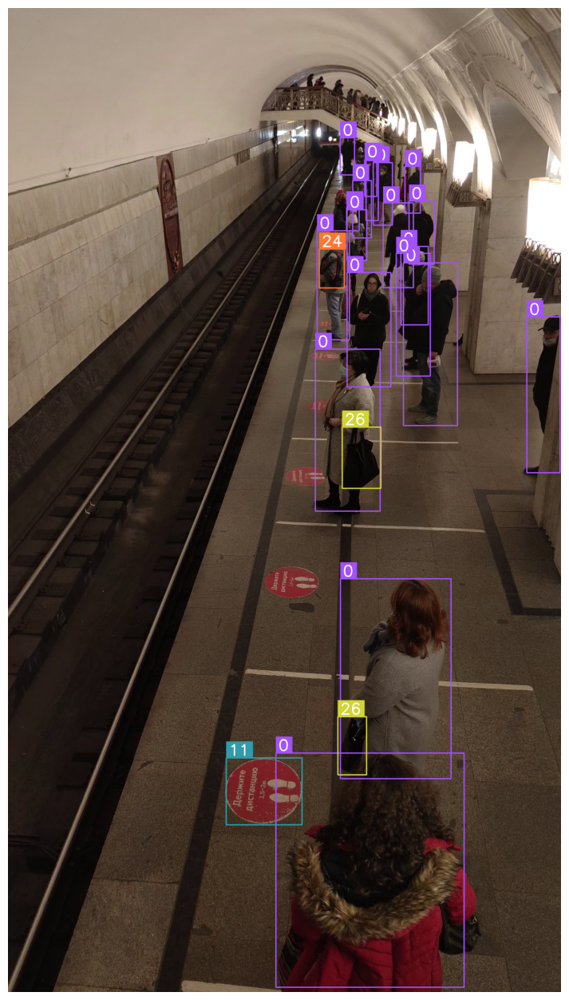

In [16]:
# extract video frame
generator = sv.get_video_frames_generator(VideoAssets.SUBWAY.value)
iterator = iter(generator)
frame = next(iterator)

# detect
outputs = predictor(frame)
detections = sv.Detections(
    xyxy=outputs["instances"].pred_boxes.tensor.cpu().numpy(),
    confidence=outputs["instances"].scores.cpu().numpy(),
    class_id=outputs["instances"].pred_classes.cpu().numpy().astype(int)
)

# annotate
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4, text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detections)
frame = label_annotator.annotate(scene=frame, detections=detections)

%matplotlib inline
sv.plot_image(frame, (16,16))


0: 1280x736 12 persons, 1 backpack, 2 handbags, 1 teddy bear, 39.8ms
Speed: 12.8ms preprocess, 39.8ms inference, 1.3ms postprocess per image at shape (1, 3, 1280, 736)


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


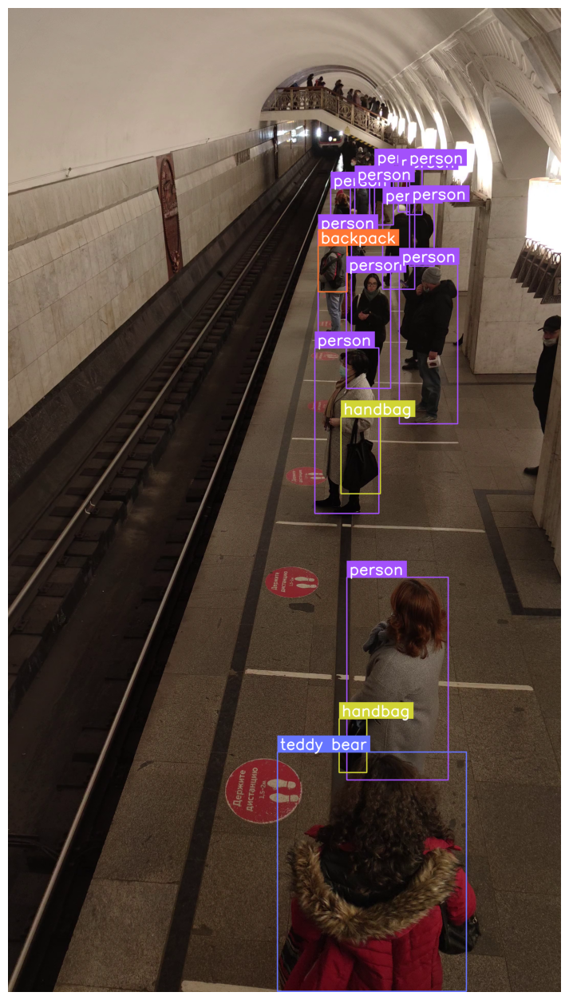

In [17]:
# extract the vidoe frame
generator = sv.get_video_frames_generator(VideoAssets.SUBWAY.value)
iterator = iter(generator)
frame = next(iterator)

# detect
results = model(frame,imgsz=1280)[0]
detection = sv.Detections.from_ultralytics(results)

# annotate
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4,text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detection)
frame = label_annotator.annotate(scene=frame, detections=detection)

# display
%matplotlib inline
sv.plot_image(frame, size=(16,16))


0: 1280x736 12 persons, 1 backpack, 2 handbags, 1 teddy bear, 13.4ms
Speed: 8.5ms preprocess, 13.4ms inference, 1.3ms postprocess per image at shape (1, 3, 1280, 736)


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


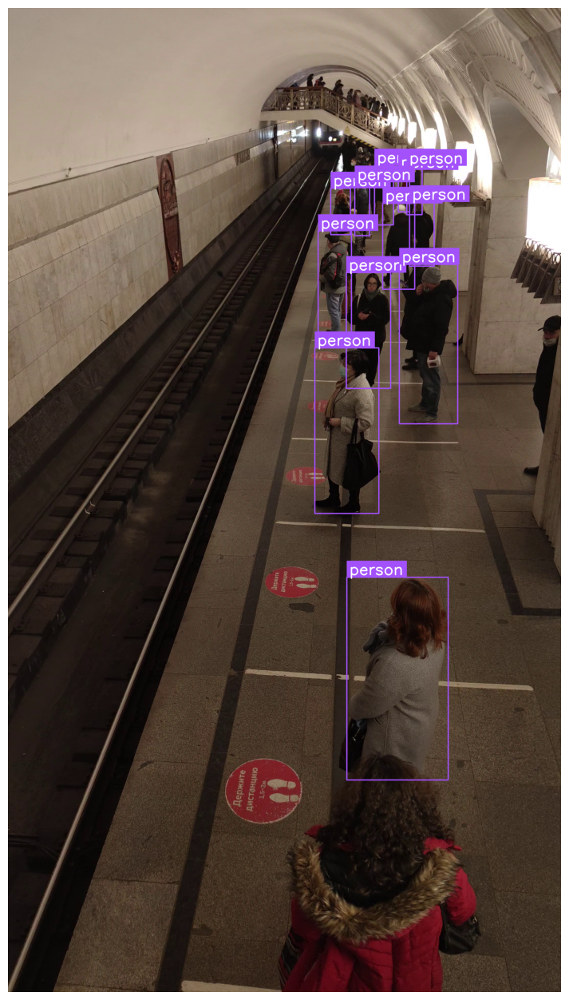

In [18]:
# extract the vidoe frame
generator = sv.get_video_frames_generator(VideoAssets.SUBWAY.value)
iterator = iter(generator)
frame = next(iterator)

# detect
results = model(frame,imgsz=1280)[0]
detection = sv.Detections.from_ultralytics(results)
detection = detection[detection.class_id == 0]

# annotate
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4,text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detection)
frame = label_annotator.annotate(scene=frame, detections=detection)

# display
%matplotlib inline
sv.plot_image(frame, size=(16,16))

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


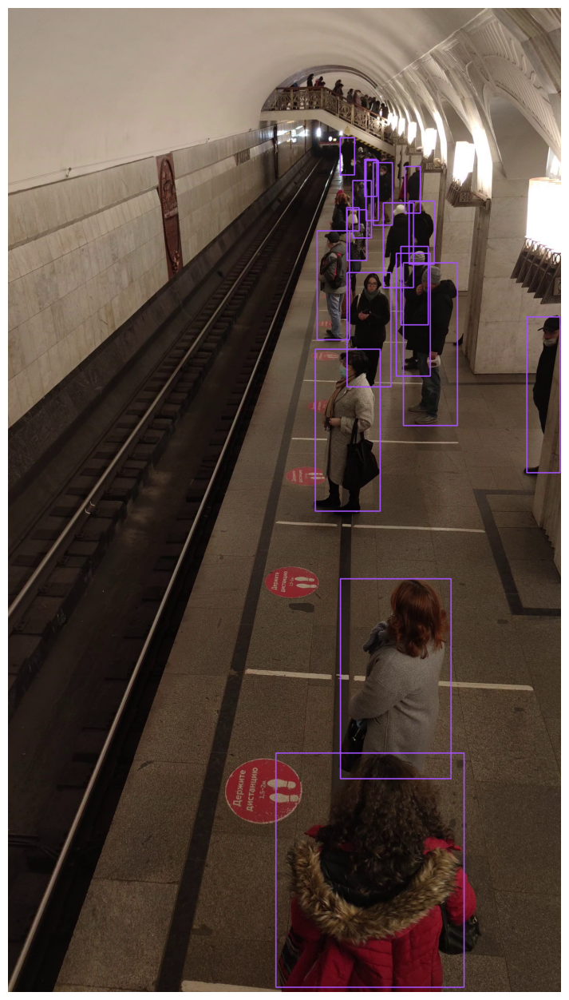

In [19]:
# extract video frame
generator = sv.get_video_frames_generator(VideoAssets.SUBWAY.value)
iterator = iter(generator)
frame = next(iterator)

# detect
outputs = predictor(frame)
detections = sv.Detections(
    xyxy=outputs["instances"].pred_boxes.tensor.cpu().numpy(),
    confidence=outputs["instances"].scores.cpu().numpy(),
    class_id=outputs["instances"].pred_classes.cpu().numpy().astype(int)
)
detections=detections[detections.class_id == 0]

# annotate
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
# label_annotator = sv.LabelAnnotator(text_thickness=4, text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detections)
# frame = label_annotator.annotate(scene=frame, detections=detections)

%matplotlib inline
sv.plot_image(frame, (16,16))

In [20]:
sv.VideoInfo.from_video_path(VideoAssets.SUBWAY.value)

VideoInfo(width=2160, height=3840, fps=29, total_frames=1298)

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


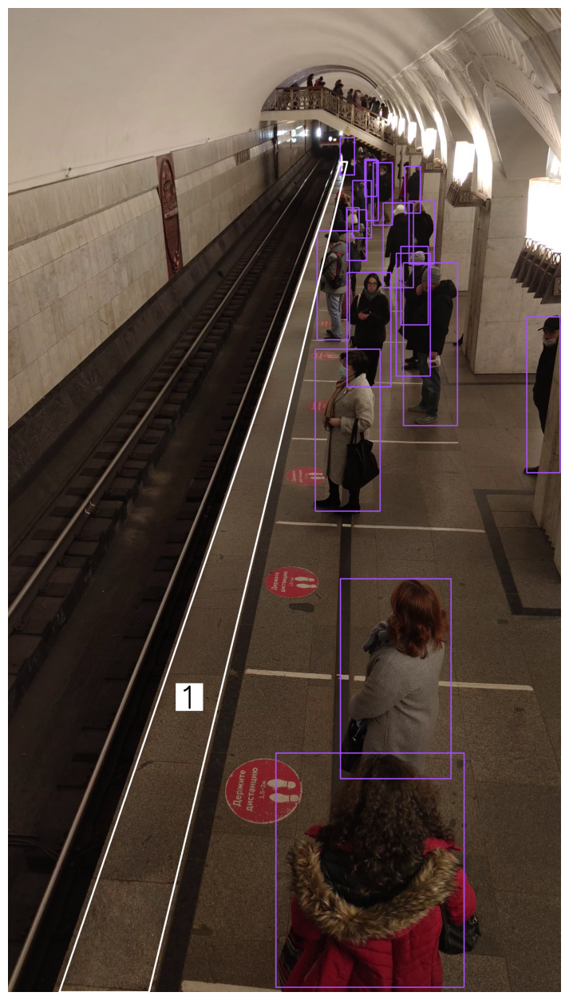

In [21]:
# initiate polygon zone
polygon = np.array([
    [200,3840],
    [1300,600],
    [1325,600],
    [550,3840]
])
# video_info = sv.VideoInfo.from_video_path(VideoAssets.SUBWAY.value)
zone = sv.PolygonZone(polygon=polygon)

# initiate annotator
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
zone_annotator = sv.PolygonZoneAnnotator(zone=zone,color=sv.Color.WHITE, thickness=6, text_thickness=6, text_scale=4)

# extract video frame
generator =sv.get_video_frames_generator(VideoAssets.SUBWAY.value)
iterator = iter(generator)
frame = next(iterator)

# detect
outputs = predictor(frame)
detections = sv.Detections(
    xyxy=outputs["instances"].pred_boxes.tensor.cpu().numpy(),
    confidence=outputs["instances"].scores.cpu().numpy(),
    class_id=outputs["instances"].pred_classes.cpu().numpy().astype(int)
)

detections = detections[detections.class_id == 0]
zone.trigger(detections=detections)

# annotate
frame = box_annotator.annotate(scene=frame, detections=detections)
frame = zone_annotator.annotate(scene=frame)

%matplotlib inline
sv.plot_image(frame, (16,16))

old code for whole video

In [22]:
# initiate polygon zone
polygon = np.array([
    [200,3840],
    [1300,600],
    [1325,600],
    [550,3840]
])
video_info = sv.VideoInfo.from_video_path(VideoAssets.SUBWAY.value)
zone = sv.PolygonZone(polygon=polygon)

# initiate annotators
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4,text_scale=2)
zone_annotator = sv.PolygonZoneAnnotator(zone=zone, color=sv.Color.WHITE, thickness=6, text_thickness=6, text_scale=4)

def process_frame(frame: np.ndarray, _) -> np.ndarray:
    # detect
    results = model(frame,imgsz=1280)[0]
    detection = sv.Detections.from_ultralytics(results)
    detection = detection[detection.class_id == 0]
    zone.trigger(detections = detection)

    # annotate
    labels = [f"{model.names[class_id]} {confidence:0.2f}" for _,_,confidence,class_id,_,_ in detection]
    frame = box_annotator.annotate(scene=frame, detections=detection)
    frame = label_annotator.annotate(scene=frame, detections=detection, labels=labels)
    frame = zone_annotator.annotate(scene=frame)

    return frame

sv.process_video(source_path=VideoAssets.SUBWAY.value, target_path=f"/content/subway_old.mp4",callback=process_frame)

display.clear_output()

New code on whole video

In [23]:
polygon = np.array([
    [200,3840],
    [1300,600],
    [1325,600],
    [550,3840]
])

video_info = sv.VideoInfo.from_video_path(VideoAssets.SUBWAY.value)
zone = sv.PolygonZone(polygon=polygon)

# initiate annotator
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
zone_annotator =sv.PolygonZoneAnnotator(zone=zone, color=sv.Color.WHITE, thickness=6, text_thickness=5, text_scale=4)

def process_frame(frame: np.ndarray, i: int) -> np.ndarray:
  # detect
  outputs = predictor(frame)
  detections = sv.Detections(
      xyxy=outputs["instances"].pred_boxes.tensor.cpu().numpy(),
      confidence=outputs["instances"].scores.cpu().numpy(),
      class_id=outputs["instances"].pred_classes.cpu().numpy().astype(int)
  )

  detections = detections[detections.class_id ==0]
  zone.trigger(detections=detections)

  # annotate
  frame = box_annotator.annotate(scene=frame, detections=detections)
  frame = zone_annotator.annotate(scene=frame)

  return frame

sv.process_video(source_path=VideoAssets.SUBWAY.value, target_path="/content/subway-result.mp4",callback=process_frame)

display.clear_output()

# Advance YOLOv5 Market Square Example

In [24]:
model = torch.hub.load('ultralytics/yolov5','yolov5x6')

Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip


requirements: Ultralytics requirements ['gitpython>=3.1.30', 'pillow>=10.3.0'] not found, attempting AutoUpdate...
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 13.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 137.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 232.9 MB/s eta 0:00:00
  Attempting uninstall: pillow
    Found existing installation: Pillow 9.4.0
    Uninstalling Pillow-9.4.0:
      Successfully uninstalled Pillow-9.4.0

requirements: AutoUpdate success ✅ 4.1s, installed 2 packages: ['gitpython>=3.1.30', 'pillow>=10.3.0']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



YOLOv5 🚀 2024-9-15 Python-3.10.12 torch-2.4.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

100%|██████████| 270M/270M [00:05<00:00, 55.0MB/s]

Fusing layers... 
YOLOv5x6 summary: 574 layers, 140730220 parameters, 0 gradients, 209.6 GFLOPs
Adding AutoShape... 


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


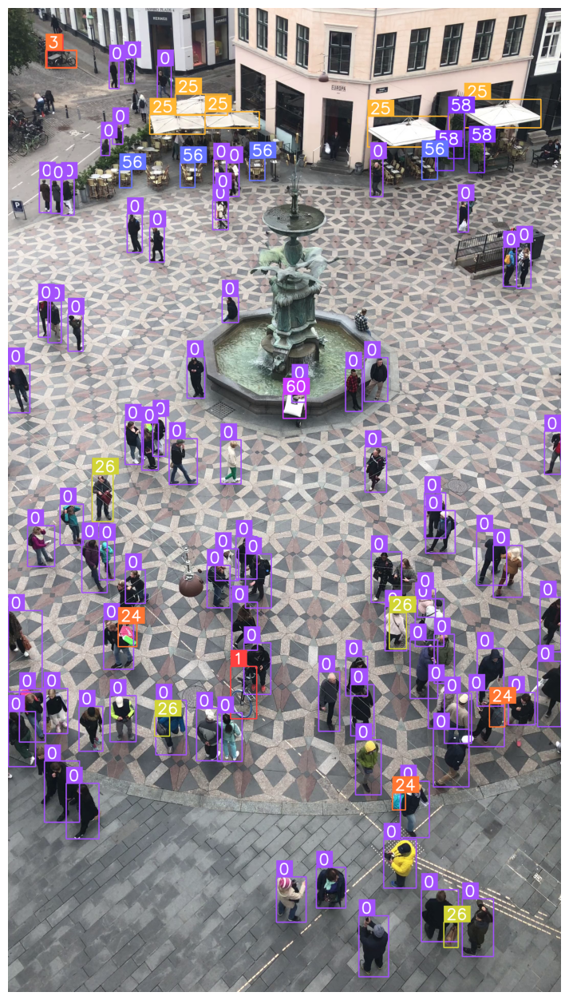

In [25]:
# extract video frame
generator = sv.get_video_frames_generator(VideoAssets.MARKET_SQUARE.value)
iterator = iter(generator)
frame = next(iterator)


# detect
results = model(frame,size=1280)
detections = sv.Detections.from_yolov5(results)

# annotate
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4,text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detections)
frame = label_annotator.annotate(scene=frame, detections=detections)

%matplotlib inline
sv.plot_image(frame, (16,16))

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


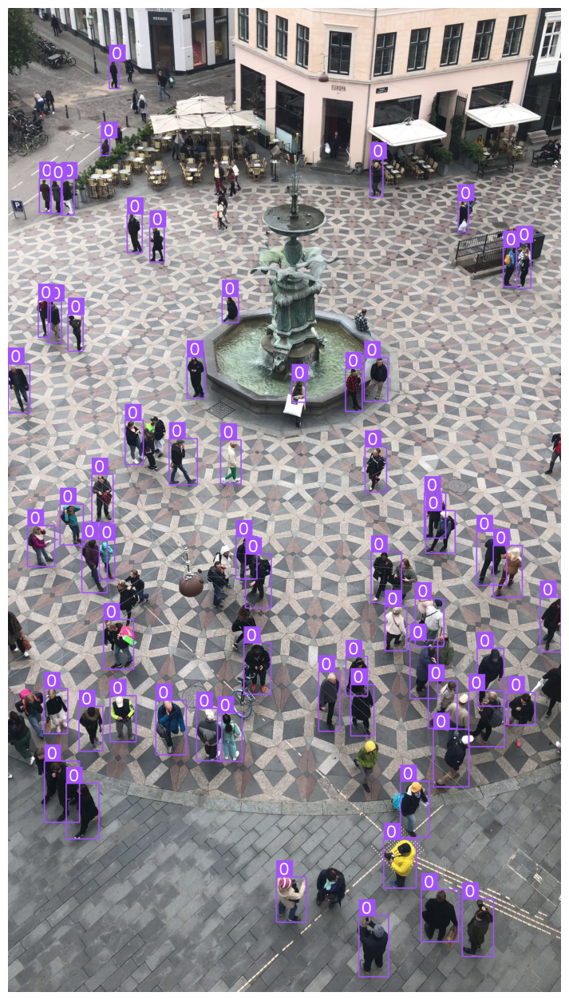

In [26]:
# remove extra detections and conf<0.5
generator = sv.get_video_frames_generator(VideoAssets.MARKET_SQUARE.value)
iterator = iter(generator)
frame = next(iterator)

# detect
results = model(frame,size=1280)
detections = sv.Detections.from_yolov5(results)
detections = detections[(detections.class_id == 0) & (detections.confidence >= 0.5)]

# annotate
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4,text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detections)
frame = label_annotator.annotate(scene=frame, detections=detections)

%matplotlib inline
sv.plot_image(frame, (16,16))

people in some portion

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


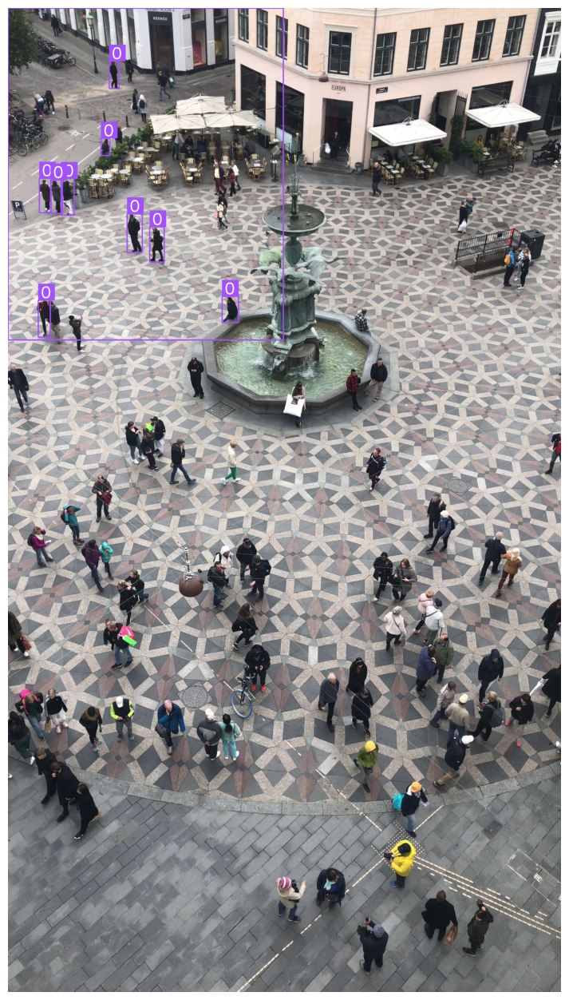

In [27]:
polygon = np.array([
    [0,0],
    [1080-5,0],
    [1080-5,1300-5],
    [0,1300-5]
])

video_info = sv.VideoInfo.from_video_path(VideoAssets.MARKET_SQUARE.value)
zone = sv.PolygonZone(polygon=polygon)

# extract video frame
generator = sv.get_video_frames_generator(VideoAssets.MARKET_SQUARE.value)
iterator = iter(generator)
frame = next(iterator)

# detect
results =model(frame,size=1280)
detections = sv.Detections.from_yolov5(results)
mask = zone.trigger(detections=detections)
detections = detections[(detections.class_id == 0) & (detections.confidence >=0.5) & mask]

# annotate
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4,text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detections)
frame = label_annotator.annotate(scene=frame, detections= detections)
frame = sv.draw_polygon(scene=frame, polygon=polygon, color=sv.Color.ROBOFLOW, thickness=4)

%matplotlib inline
sv.plot_image(frame, (16,16))

In [28]:
polygon = np.array([
    [540,  985],
    [1620, 985],
    [2160, 1920],
    [1620, 2855],
    [540,  2855],
    [0,    1920]
])

video_info = sv.VideoInfo.from_video_path(VideoAssets.MARKET_SQUARE.value)
zone = sv.PolygonZone(polygon=polygon)

# extract video frame
generator = sv.get_video_frames_generator(VideoAssets.MARKET_SQUARE.value)
iterator = iter(generator)
frame = next(iterator)

# initiate annotator
box_annotator = sv.BoundingBoxAnnotator(thickness=4)
label_annotator = sv.LabelAnnotator(text_thickness=4,text_scale=2)
zone_annotator = sv.PolygonZoneAnnotator(zone=zone, color=sv.Color.ROBOFLOW, thickness=6,text_thickness=6,text_scale=4)

def process_frame(frame: np.ndarray, i: int) -> np.ndarray:  # annotate
  # detect
  results =model(frame,size=1280)
  detections = sv.Detections.from_yolov5(results)
  mask = zone.trigger(detections=detections)
  detections = detections[(detections.class_id == 0) & (detections.confidence >=0.5) & mask]


  frame = box_annotator.annotate(scene=frame, detections=detections)
  frame = label_annotator.annotate(scene=frame, detections= detections)
  frame = zone_annotator.annotate(scene=frame)

  return frame

sv.process_video(source_path=VideoAssets.MARKET_SQUARE.value, target_path=f"park_myself.mp4",callback=process_frame)

display.clear_output()

more complex behaviours

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.
SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.
SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.
SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


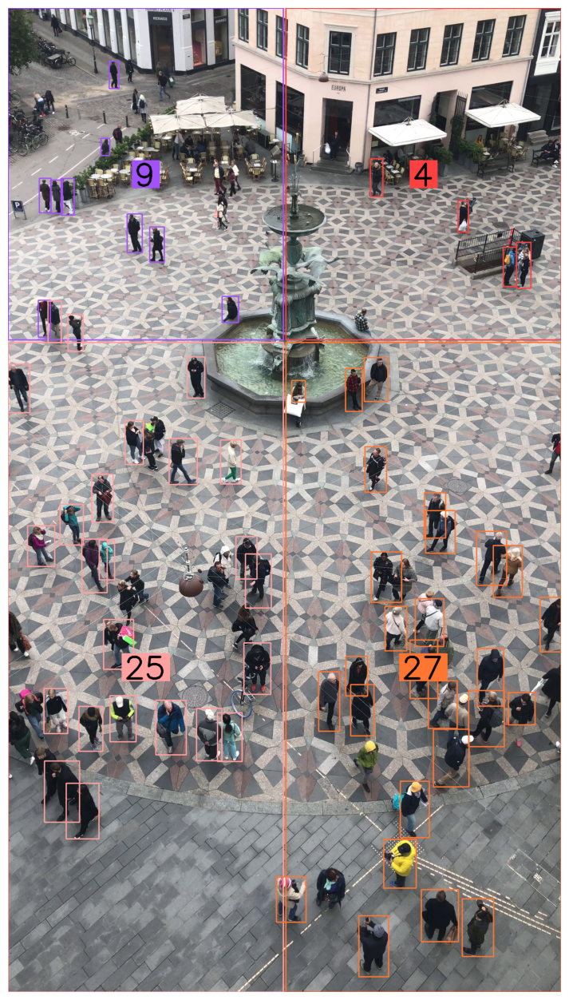

In [29]:
colors = sv.ColorPalette.DEFAULT
polygons = [
    np.array([
        [0, 0],
        [1080 - 5, 0],
        [1080 - 5, 1300 - 5],
        [0, 1300 - 5]
    ], np.int32),
    np.array([
        [1080 + 5, 0],
        [2160, 0],
        [2160, 1300 - 5],
        [1080 + 5, 1300 - 5]
    ], np.int32),
    np.array([
        [0, 1300 + 5],
        [1080 - 5, 1300 + 5],
        [1080 - 5, 3840],
        [0, 3840]
    ], np.int32),
    np.array([
        [1080 + 5, 1300 + 5],
        [2160, 1300 + 5],
        [2160, 3840],
        [1080 + 5, 3840]
    ], np.int32)
]
video_info = sv.VideoInfo.from_video_path(VideoAssets.MARKET_SQUARE.value)

zones = [sv.PolygonZone(polygon=polygon) for polygon in polygons]
zone_annotators = [
    sv.PolygonZoneAnnotator(
        zone=zone,
        color=colors.by_idx(index),
        thickness=4,
        text_thickness=8,
        text_scale=4
    )
    for index, zone
    in enumerate(zones)
]
box_annotators = [
    sv.BoundingBoxAnnotator(
        color=colors.by_idx(index),
        thickness=4,
    )
    for index
    in range(len(polygons))
]

# extract video frame
generator = sv.get_video_frames_generator(VideoAssets.MARKET_SQUARE.value)
iterator = iter(generator)
frame = next(iterator)

# detect
results = model(frame, size=1280)
detections = sv.Detections.from_yolov5(results)
detections = detections[(detections.class_id == 0) & (detections.confidence > 0.5)]

for zone, zone_annotator, box_annotator in zip(zones, zone_annotators, box_annotators):
    mask = zone.trigger(detections=detections)
    detections_filtered = detections[mask]
    frame = box_annotator.annotate(scene=frame, detections=detections_filtered)
    frame = zone_annotator.annotate(scene=frame)

%matplotlib inline
sv.plot_image(frame, (16, 16))

In [31]:
colors = sv.ColorPalette.DEFAULT
polygons = [
    np.array([
        [0, 0],
        [1080 - 5, 0],
        [1080 - 5, 1300 - 5],
        [0, 1300 - 5]
    ], np.int32),
    np.array([
        [1080 + 5, 0],
        [2160, 0],
        [2160, 1300 - 5],
        [1080 + 5, 1300 - 5]
    ], np.int32),
    np.array([
        [0, 1300 + 5],
        [1080 - 5, 1300 + 5],
        [1080 - 5, 3840],
        [0, 3840]
    ], np.int32),
    np.array([
        [1080 + 5, 1300 + 5],
        [2160, 1300 + 5],
        [2160, 3840],
        [1080 + 5, 3840]
    ], np.int32)
]
video_info = sv.VideoInfo.from_video_path(VideoAssets.MARKET_SQUARE.value)

zones = [sv.PolygonZone(polygon=polygon) for polygon in polygons]
zone_annotators = [
    sv.PolygonZoneAnnotator(
        zone=zone,
        color=colors.by_idx(index),
        thickness=4,
        text_thickness=8,
        text_scale=4
    )
    for index, zone
    in enumerate(zones)
]
box_annotators = [
    sv.BoundingBoxAnnotator(
        color=colors.by_idx(index),
        thickness=4,
    )
    for index
    in range(len(polygons))
]

# extract video frame
generator = sv.get_video_frames_generator(VideoAssets.MARKET_SQUARE.value)
iterator = iter(generator)
frame = next(iterator)

def process_frame(frame: np.ndarray, i: int) -> np.ndarray:
  # detect
  results = model(frame, size=1280)
  detections = sv.Detections.from_yolov5(results)
  detections = detections[(detections.class_id == 0) & (detections.confidence > 0.5)]

  for zone, zone_annotator, box_annotator in zip(zones, zone_annotators, box_annotators):
      mask = zone.trigger(detections=detections)
      detections_filtered = detections[mask]
      frame = box_annotator.annotate(scene=frame, detections=detections_filtered)
      frame = zone_annotator.annotate(scene=frame)

  return frame

sv.process_video(source_path=VideoAssets.MARKET_SQUARE.value, target_path=f"park_myself2.mp4",callback=process_frame)

display.clear_output()